In [2]:
import cdsapi
import numpy as np
import pandas as pd
import seaborn as sns
import xarray as xr
import netCDF4 as nc
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from tqdm.notebook import tqdm

In [3]:
from sklearn.preprocessing import MinMaxScaler  
from sklearn.model_selection import train_test_split
from sklearn.metrics import explained_variance_score, max_error, mean_absolute_error, mean_squared_error, r2_score

Description of Datasets from the source(Copernicus Data Store (CDS))

Dataset 1: 
Temperature of air at 2m above the surface of land, sea or in-land waters. 2m temperature is calculated by 
interpolating between the lowest model level and the Earth's surface, taking account of the atmospheric conditions. 
Temperature measured in kelvin can be converted to degrees Celsius (°C) by subtracting 273.15.

Dataset 2:
Volume of water in soil layer 1 (0 - 7 cm) of the ECMWF Integrated Forecasting System. The surface is at 0 cm. The volumetric soil water is associated with the soil texture (or classification), soil depth, and the underlying groundwater level.

Dataset 3:
Accumulated liquid and frozen water, including rain and snow, that falls to the Earth's surface. It is the sum of large-scale precipitation (that precipitation which is generated by large-scale weather patterns, such as troughs and cold fronts) and convective precipitation (generated by convection which occurs when air at lower levels in the atmosphere is warmer and less dense than the air above, so it rises). Precipitation variables do not include fog, dew or the precipitation that evaporates in the atmosphere before it lands at the surface of the Earth. This variable is accumulated from the beginning of the forecast time to the end of the forecast step. The units of precipitation are depth in metres. It is the depth the water would have if it were spread evenly over the grid box. Care should be taken when comparing model variables with observations, because observations are often local to a particular point in space and time, rather than representing averages over a model grid box and model time step.

In [ ]:
c = cdsapi.Client()

In [ ]:
c.retrieve(
    'reanalysis-era5-land',
    {
        'variable': 'volumetric_soil_water_layer_1',
        'year': '2019',
        'month': '12',
        'day': 
        [
            '01', '02', '03',
            '04', '05', '06',
            '07', '08', '09',
            '10', '11', '12',
            '13', '14', '15',
            '16', '17', '18',
            '19', '20', '21',
            '22', '23', '24',
            '25', '26', '27',
            '28', '29', '30',
            '31',
        ],
        'time': '12:00',
        'format': 'netcdf',
    },
    'VSWL1.nc')

In [ ]:
c.retrieve(
    'reanalysis-era5-land',
    {
        'variable': '2m_temperature',
        'year': '2019',
        'month': '12',
        'day': 
        [
            '01', '02', '03',
            '04', '05', '06',
            '07', '08', '09',
            '10', '11', '12',
            '13', '14', '15',
            '16', '17', '18',
            '19', '20', '21',
            '22', '23', '24',
            '25', '26', '27',
            '28', '29', '30',
            '31',
        ],
        'time': '12:00',
        'format': 'netcdf',
    },
    'temp.nc')

In [ ]:
c.retrieve(
    'reanalysis-era5-land',
    {
        'variable': 'total_precipitation',
        'year': '2019',
        'month': '12',
        'day': 
        [
            '01', '02', '03',
            '04', '05', '06',
            '07', '08', '09',
            '10', '11', '12',
            '13', '14', '15',
            '16', '17', '18',
            '19', '20', '21',
            '22', '23', '24',
            '25', '26', '27',
            '28', '29', '30',
            '31',
        ],
        'time': '12:00',
        'format': 'netcdf',
    },
    'Precipitation.nc')

In [87]:
d1=xr.open_dataset("temp.nc")
d2=xr.open_dataset("VSWL1.nc")
d3=xr.open_dataset("Precipitation.nc")

In the following cells we can see that all datasets have the same dimensions but different variables.

The dimentions are: 

Latitude- 1801 values ranging from 0 to 359.9 (Increments of 0.1)
Longitude- 3600 values ranging from -90.0 to 90.0 (Increments of 0.1)
Time- 31 values ranging from Dec 1,2019 to Dec 31,2019 (Increments of 1 day)

In [4]:
d1

<xarray.Dataset>
Dimensions:    (latitude: 1801, longitude: 3600, time: 31)
Coordinates:
  * longitude  (longitude) float32 0.0 0.1 0.2 0.3 ... 359.6 359.7 359.8 359.9
  * latitude   (latitude) float32 90.0 89.9 89.8 89.7 ... -89.8 -89.9 -90.0
  * time       (time) datetime64[ns] 2019-12-01T12:00:00 ... 2019-12-31T12:00:00
Data variables:
    t2m        (time, latitude, longitude) float32 ...
Attributes:
    Conventions:  CF-1.6
    history:      2020-10-23 16:32:20 GMT by grib_to_netcdf-2.16.0: /opt/ecmw...

In [5]:
d2

<xarray.Dataset>
Dimensions:    (latitude: 1801, longitude: 3600, time: 31)
Coordinates:
  * longitude  (longitude) float32 0.0 0.1 0.2 0.3 ... 359.6 359.7 359.8 359.9
  * latitude   (latitude) float32 90.0 89.9 89.8 89.7 ... -89.8 -89.9 -90.0
  * time       (time) datetime64[ns] 2019-12-01T12:00:00 ... 2019-12-31T12:00:00
Data variables:
    swvl1      (time, latitude, longitude) float32 ...
Attributes:
    Conventions:  CF-1.6
    history:      2020-10-25 09:11:16 GMT by grib_to_netcdf-2.16.0: /opt/ecmw...

In [6]:
d3

<xarray.Dataset>
Dimensions:    (latitude: 1801, longitude: 3600, time: 31)
Coordinates:
  * longitude  (longitude) float32 0.0 0.1 0.2 0.3 ... 359.6 359.7 359.8 359.9
  * latitude   (latitude) float32 90.0 89.9 89.8 89.7 ... -89.8 -89.9 -90.0
  * time       (time) datetime64[ns] 2019-12-01T12:00:00 ... 2019-12-31T12:00:00
Data variables:
    tp         (time, latitude, longitude) float32 ...
Attributes:
    Conventions:  CF-1.6
    history:      2020-10-25 09:10:24 GMT by grib_to_netcdf-2.16.0: /opt/ecmw...

<b>Attributes of the datarays, with information on how the data is handled</b>

scale_factor: If present for a variable, the data are to be multiplied by this factor after the data are read by the application that accesses the data.

add_offset: If present for a variable, this number is to be added to the data after it is read by the application that accesses the data. If both scale_factor and add_offset attributes are present, the data are first scaled before the offset is added. The attributes scale_factor and add_offset can be used together to provide simple data compression to store low-resolution floating-point data as small integers in a netCDF dataset. When scaled data are written, the application should first subtract the offset and then divide by the scale factor, rounding the result to the nearest integer to avoid a bias caused by truncation towards zero.

The _FillValue attribute specifies the fill value used to pre-fill disk space allocated to the variable. Such pre-fill occurs unless nofill mode is set using nc_set_fill(). The fill value is returned when reading values that were never written. If _FillValue is defined then it should be scalar and of the same type as the variable. If the variable is packed using scale_factor and add_offset attributes (see below), the _FillValue attribute should have the data type of the packed data.

missing_value is not treated in any special way by the library or conforming generic applications, but is often useful documentation and may be used by specific applications. The missing_value attribute can be a scalar or vector containing values indicating missing data. These values should all be outside the valid range so that generic applications will treat them as missing.

In [7]:
print(nc.Dataset("temp.nc")['t2m'])

<class 'netCDF4._netCDF4.Variable'>
int16 t2m(time, latitude, longitude)
    scale_factor: 0.0014723647569050374
    add_offset: 269.5286903923286
    _FillValue: -32767
    missing_value: -32767
    units: K
    long_name: 2 metre temperature
unlimited dimensions: 
current shape = (31, 1801, 3600)
filling on


In [8]:
print(nc.Dataset("VSWL1.nc")['swvl1'])

<class 'netCDF4._netCDF4.Variable'>
int16 swvl1(time, latitude, longitude)
    scale_factor: 1.1688866215899814e-05
    add_offset: 0.3829973904301733
    _FillValue: -32767
    missing_value: -32767
    units: m**3 m**-3
    long_name: Volumetric soil water layer 1
unlimited dimensions: 
current shape = (31, 1801, 3600)
filling on


In [9]:
print(nc.Dataset("Precipitation.nc")['tp'])

<class 'netCDF4._netCDF4.Variable'>
int16 tp(time, latitude, longitude)
    scale_factor: 3.340191700098996e-06
    add_offset: 0.1094447212454437
    _FillValue: -32767
    missing_value: -32767
    units: m
    long_name: Total precipitation
unlimited dimensions: 
current shape = (31, 1801, 3600)
filling on


(array([  321574.,  3954441., 14419857., 10647769., 10623027.,  6757909.,
         4377244.,  8346348.,  8174480.,   976104.]),
 array([221.28519, 230.93404, 240.58289, 250.23172, 259.88058, 269.52942,
        279.17825, 288.82712, 298.47595, 308.12482, 317.77365],
       dtype=float32),
 <a list of 10 Patch objects>)

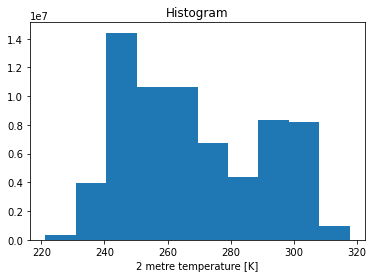

In [10]:
d1.t2m.plot()

(array([ 7662084.,  4145751., 14999080., 12867079., 16728351.,  8844565.,
         2057516.,   700088.,   566021.,    28218.]),
 array([0.        , 0.07660065, 0.1532013 , 0.22980194, 0.3064026 ,
        0.38300323, 0.45960388, 0.5362045 , 0.6128052 , 0.6894058 ,
        0.76600647], dtype=float32),
 <a list of 10 Patch objects>)

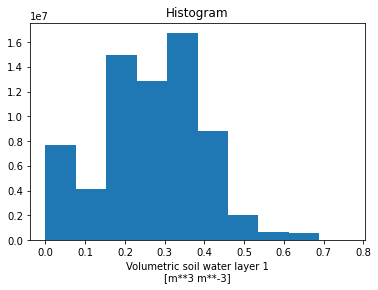

In [11]:
d2.swvl1.plot()

(array([6.8436371e+07, 1.4117100e+05, 1.5473000e+04, 3.8770000e+03,
        1.1820000e+03, 4.5600000e+02, 1.6200000e+02, 5.2000000e+01,
        7.0000000e+00, 2.0000000e+00]),
 array([7.4505806e-09, 2.1889284e-02, 4.3778561e-02, 6.5667838e-02,
        8.7557115e-02, 1.0944639e-01, 1.3133568e-01, 1.5322495e-01,
        1.7511423e-01, 1.9700350e-01, 2.1889278e-01], dtype=float32),
 <a list of 10 Patch objects>)

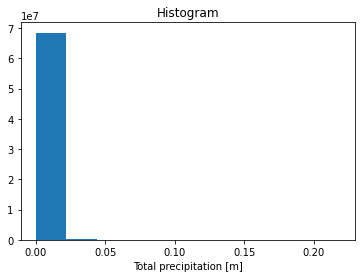

In [12]:
d3.tp.plot()

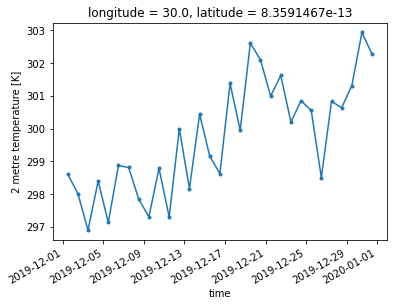

In [13]:
d1.t2m.isel(latitude=900, longitude=300).plot(marker=".")

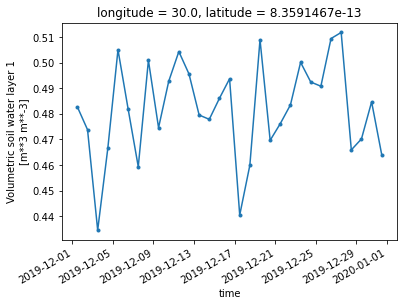

In [14]:
d2.swvl1.isel(latitude=900, longitude=300).plot(marker=".")

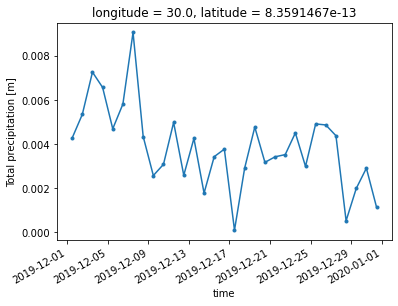

In [15]:
d3.tp.isel(latitude=900, longitude=300).plot(marker=".")

The next three cells plot the variation of the respective variable for a day for all location given with the longitude and latitude.

We can observe that the data is provided only for the places with land and does not apply for the oceans.

The first two graphs are well differentiated. Areas of similarity can easily be identified.
However , for the last one the entire map is of a single colour and cannot be intepreted at all. This can be attributed to the skewness of data as seen before with the histogram.

In [88]:
d1.t2m.isel(time=1).plot(figsize=(200, 100))

In [89]:
d2.swvl1.isel(time=1).plot(figsize=(200, 100))

In [90]:
d3.tp.isel(time=1).plot(figsize=(200, 100))

The next six graphs plot the basic statistics of the data. 

i) The first graph plots the minimum, median,mean and maximum value observed for a particular day

ii) The second graph plots the standard deviation

Again the trend continues. The first two graphs are pretty regular. The mean and median are almost the same and fall almost in the middle of both the minimum and maximum values. They are well balanced datasets.

However, from the last graph we can see that the minimum, median and mean almost fall on the same line followed by a maximum value that is far apart. From this we can conclude that the maximum of values are concentrated at the bottom. With only a few extreme values on the top. 

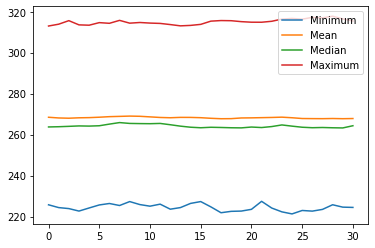

In [19]:
plt.plot(d1.groupby('time').min(...).t2m, label = "Minimum")
plt.plot(d1.groupby('time').mean(...).t2m, label = "Mean")
plt.plot(d1.groupby('time').median(...).t2m, label = "Median")
plt.plot(d1.groupby('time').max(...).t2m, label = "Maximum")
plt.legend()

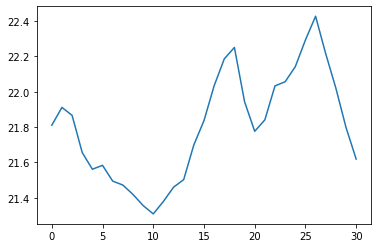

In [20]:
plt.plot(d1.groupby('time').std(...).t2m, label = "Standard Deviation")

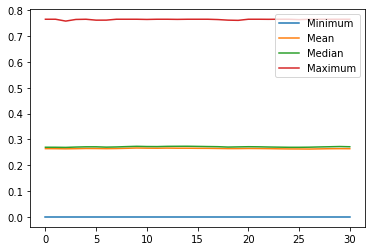

In [21]:
plt.plot(d2.groupby('time').min(...).swvl1, label = "Minimum")
plt.plot(d2.groupby('time').mean(...).swvl1, label = "Mean")
plt.plot(d2.groupby('time').median(...).swvl1, label = "Median")
plt.plot(d2.groupby('time').max(...).swvl1, label = "Maximum")
plt.legend()

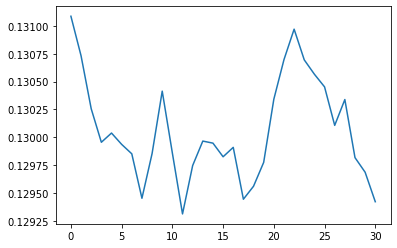

In [22]:
plt.plot(d2.groupby('time').std(...).swvl1, label = "Standard Deviation")

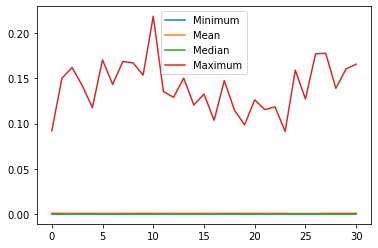

In [23]:
plt.plot(d3.groupby('time').min(...).tp, label = "Minimum")
plt.plot(d3.groupby('time').mean(...).tp, label = "Mean")
plt.plot(d3.groupby('time').median(...).tp, label = "Median")
plt.plot(d3.groupby('time').max(...).tp, label = "Maximum")
plt.legend()

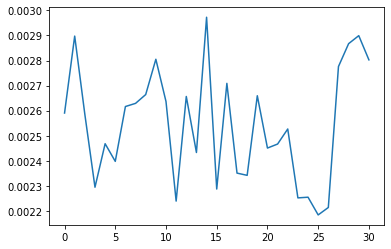

In [24]:
plt.plot(d3.groupby('time').std(...).tp, label = "Standard Deviation")

The unequal concentration of values in the total precipitation, is a cause of concern as they can make the model less powerful and intuitive. This can be corrected by performing tranforms on the data. THe next few cells deal with transforming the data with a log function and the effects it has on the data.

i)The histogram then plotted show a better varied data, though still concentrated in the lower interval is however spread to other intervals as well.
ii)The graph has become almost like the other graphs. The mean and median are almost the same and fall almost in the middle of both the minimum and maximum values
iii)The graph is well differentiated. Areas of similarity can easily be identified.

(array([24913495.,        0.,        0.,  6602140.,  8163657., 11066456.,
        10153525.,  6054693.,  1615693.,    29094.]),
 array([-18.714973 , -16.995394 , -15.275813 , -13.556233 , -11.836654 ,
        -10.117073 ,  -8.397493 ,  -6.677913 ,  -4.9583335,  -3.2387533,
         -1.5191733], dtype=float32),
 <a list of 10 Patch objects>)

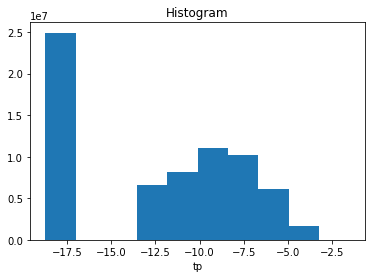

In [91]:
x1=xr.ufuncs.log(d3.tp)
d3=x1.to_dataset()
d3.tp.plot()

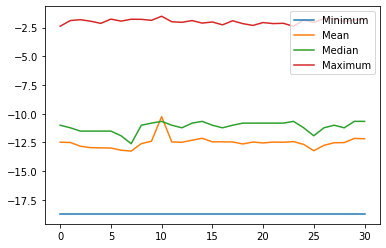

In [26]:
plt.plot(d3.groupby('time').min(...).tp, label = "Minimum")
plt.plot(d3.groupby('time').mean(...).tp, label = "Mean")
plt.plot(d3.groupby('time').median(...).tp, label = "Median")
plt.plot(d3.groupby('time').max(...).tp, label = "Maximum")
plt.legend()

In [92]:
d3.tp.isel(time=1).plot(figsize=(200, 100))

In [28]:
d1.t2m.isnull().groupby('time').sum(...)

<xarray.DataArray 't2m' (time: 31)>
array([4270737, 4270737, 4270737, 4270737, 4270737, 4270737, 4270737,
       4270737, 4270737, 4270737, 4270737, 4270737, 4270737, 4270737,
       4270737, 4270737, 4270737, 4270737, 4270737, 4270737, 4270737,
       4270737, 4270737, 4270737, 4270737, 4270737, 4270737, 4270737,
       4270737, 4270737, 4270737])
Coordinates:
  * time     (time) datetime64[ns] 2019-12-01T12:00:00 ... 2019-12-31T12:00:00

In [29]:
d2.swvl1.isnull().groupby('time').sum(...)

<xarray.DataArray 'swvl1' (time: 31)>
array([4270737, 4270737, 4270737, 4270737, 4270737, 4270737, 4270737,
       4270737, 4270737, 4270737, 4270737, 4270737, 4270737, 4270737,
       4270737, 4270737, 4270737, 4270737, 4270737, 4270737, 4270737,
       4270737, 4270737, 4270737, 4270737, 4270737, 4270737, 4270737,
       4270737, 4270737, 4270737])
Coordinates:
  * time     (time) datetime64[ns] 2019-12-01T12:00:00 ... 2019-12-31T12:00:00

In [30]:
d3.tp.isnull().groupby('time').sum(...)

<xarray.DataArray 'tp' (time: 31)>
array([4270737, 4270737, 4270737, 4270737, 4270737, 4270737, 4270737,
       4270737, 4270737, 4270737, 4270737, 4270737, 4270737, 4270737,
       4270737, 4270737, 4270737, 4270737, 4270737, 4270737, 4270737,
       4270737, 4270737, 4270737, 4270737, 4270737, 4270737, 4270737,
       4270737, 4270737, 4270737])
Coordinates:
  * time     (time) datetime64[ns] 2019-12-01T12:00:00 ... 2019-12-31T12:00:00

In [45]:
dd1=d1.loc[dict(time=slice("2019-12-01T12:00:00.000000000", "2019-12-15T12:00:00.000000000"))]
dd2=d2.loc[dict(time=slice("2019-12-01T12:00:00.000000000", "2019-12-15T12:00:00.000000000"))]
dd3=d3.loc[dict(time=slice("2019-12-01T12:00:00.000000000", "2019-12-15T12:00:00.000000000"))]

In [20]:
new_lon = np.linspace(d1.longitude[0], d1.longitude[-1], d1.dims["longitude"] * 2)
new_lat = np.linspace(d1.latitude[0], d1.latitude[-1], d1.dims["latitude"] * 2)

In [21]:
ds1 = dd1.isel(time=0).interp(latitude=new_lat, longitude=new_lon,method="linear")
for i in range(1,15):
    dsi = dd1.isel(time=i).interp(latitude=new_lat, longitude=new_lon,method="linear")
    ds1=xr.combine_nested([ds1,dsi], concat_dim="time")
ds1.to_netcdf("ds1.nc")

In [32]:
ds2 = dd2.isel(time=0).interp(latitude=new_lat, longitude=new_lon,method="linear")
for i in range(1,15):
    dsi = dd2.isel(time=i).interp(latitude=new_lat, longitude=new_lon,method="linear")
    ds2=xr.combine_nested([ds2,dsi], concat_dim="time")
ds2.to_netcdf("ds2.nc")

In [46]:
ds3 = dd3.isel(time=0).interp(latitude=new_lat, longitude=new_lon,method="linear")
for i in range(1,15):
    dsi = dd3.isel(time=i).interp(latitude=new_lat, longitude=new_lon,method="linear")
    ds3=xr.combine_nested([ds3,dsi], concat_dim="time")
ds3.to_netcdf("ds3.nc")

In [43]:
d3.tp.isel(time=1).plot(figsize=(200, 100))

In [47]:
ds3.tp.isel(time=1).plot(figsize=(200, 100))

In [93]:
df1 = ds1.to_dataframe().reset_index()
df1 = df1.drop(['latitude', 'longitude','time'], axis = 1)
df2 = ds2.to_dataframe().reset_index()
df2 = df2.drop(['latitude', 'longitude','time'], axis = 1)
df3 = ds3.to_dataframe().reset_index()
df3 = df3.drop(['latitude', 'longitude','time'], axis = 1)

In [94]:
df=pd.concat([df1, df2, df3], axis=1)
df=df.dropna(how='all')
df.to_csv("f1.csv",index=False)

In [107]:
df=pd.read_csv("f1.csv")

# Deep Learning

In [162]:
X_trainval, X_test, y_trainval, y_test = train_test_split(df[['t2m','swvl1']], df['tp'], test_size=0.1)
X_train, X_val, y_train, y_val = train_test_split(X_trainval, y_trainval, test_size=0.1)

In [163]:
scaler = MinMaxScaler()
X_train = scaler.fit_transform(X_train)
X_val = scaler.transform(X_val)
X_test = scaler.transform(X_test)

X_train, y_train = np.array(X_train), np.array(y_train)
X_val, y_val = np.array(X_val), np.array(y_val)
X_test, y_test = np.array(X_test), np.array(y_test)

In [164]:
class RegressionDataset(Dataset):
    
    def __init__(self, X_data, y_data):
        self.X_data = X_data
        self.y_data = y_data
        
    def __getitem__(self, index):
        return self.X_data[index], self.y_data[index]
        
    def __len__ (self):
        return len(self.X_data)

train_dataset = RegressionDataset(torch.from_numpy(X_train).float(), torch.from_numpy(y_train).float())
val_dataset = RegressionDataset(torch.from_numpy(X_val).float(), torch.from_numpy(y_val).float())
test_dataset = RegressionDataset(torch.from_numpy(X_test).float(), torch.from_numpy(y_test).float())

In [165]:
epochs = 5
BATCH_SIZE = 64
alpha = 0.001
inputs = 2

In [166]:
train_loader = DataLoader(dataset=train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(dataset=val_dataset, batch_size=1)
test_loader = DataLoader(dataset=test_dataset, batch_size=1)

In [167]:
class MultipleRegression(nn.Module):
    def __init__(self, num_features):
        super(MultipleRegression, self).__init__()
        self.layer_1 = nn.Linear(inputs, 1)
        self.layer_2 = nn.Linear(1, 2)
        #self.layer_3 = nn.Linear(5, 3)
        self.layer_out = nn.Linear(2, 1)
        self.relu = nn.ReLU()

    def forward(self, inputs):
        x = self.relu(self.layer_1(inputs))
        x = self.relu(self.layer_2(x))
        #x = self.relu(self.layer_3(x))
        x = self.layer_out(x)
        return (x)

In [168]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = MultipleRegression(inputs)
model.to(device)
print(model)
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=alpha)

MultipleRegression(
  (layer_1): Linear(in_features=2, out_features=1, bias=True)
  (layer_2): Linear(in_features=1, out_features=2, bias=True)
  (layer_out): Linear(in_features=2, out_features=1, bias=True)
  (relu): ReLU()
)


In [169]:
loss_stats = {
    'train': [],
    "val": []
}

In [170]:
for e in tqdm(range(0, epochs)):
    train_epoch_loss = 0
    model.train()
    
    for X_train_batch, y_train_batch in train_loader:
        X_train_batch, y_train_batch = X_train_batch.to(device), y_train_batch.to(device)
        optimizer.zero_grad()
        y_train_pred = model(X_train_batch)
        train_loss = criterion(y_train_pred, y_train_batch.unsqueeze(1))
        train_loss.backward()
        optimizer.step()
        train_epoch_loss += train_loss.item()
        
        
    with torch.no_grad():
        val_epoch_loss = 0
        model.eval()
        for X_val_batch, y_val_batch in val_loader:
            X_val_batch, y_val_batch = X_val_batch.to(device), y_val_batch.to(device)    
            y_val_pred = model(X_val_batch)
            val_loss = criterion(y_val_pred, y_val_batch.unsqueeze(1))
            val_epoch_loss += val_loss.item()

    loss_stats['train'].append(train_epoch_loss/len(train_loader))
    loss_stats['val'].append(val_epoch_loss/len(val_loader))                              
    
    print(f'Epoch {e+0:03}: | Train Loss: {train_epoch_loss/len(train_loader):.5f} | Val Loss: {val_epoch_loss/len(val_loader):.5f}')

Epoch 000: | Train Loss: 0.00157 | Val Loss: 0.00000
Epoch 001: | Train Loss: 0.00000 | Val Loss: 0.00000
Epoch 002: | Train Loss: 0.00000 | Val Loss: 0.00000
Epoch 003: | Train Loss: 0.00000 | Val Loss: 0.00000
Epoch 004: | Train Loss: 0.00000 | Val Loss: 0.00000



Text(0.5, 1.0, 'Train-Val Loss/Epoch')

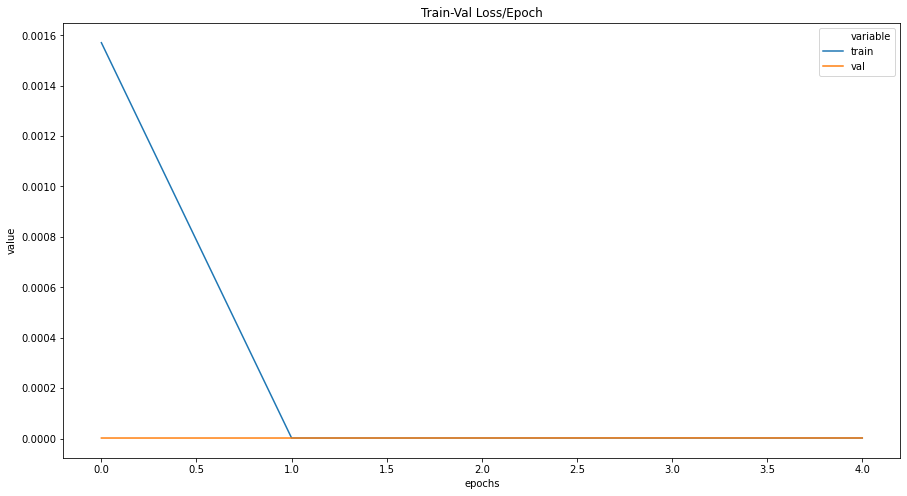

In [171]:
train_val_loss_df = pd.DataFrame.from_dict(loss_stats).reset_index().melt(id_vars=['index']).rename(columns={"index":"epochs"})
plt.figure(figsize=(15,8))
sns.lineplot(data=train_val_loss_df, x = "epochs", y="value", hue="variable").set_title('Train-Val Loss/Epoch')

In [172]:
y_pred = []
with torch.no_grad():
    model.eval()
    for X_batch, _ in test_loader:
        X_batch = X_batch.to(device)
        y_test_pred = model(X_batch)
        y_pred.append(y_test_pred.cpu().numpy())
y_pred = [a.squeeze().tolist() for a in y_pred]

In [175]:
print("Explained Variance:",explained_variance_score(y_test, y_pred))
print("Maximum Error:",max_error(y_test, y_pred))
print("Mean Absolute Error:",mean_absolute_error(y_test, y_pred))
print("Mean Squared Error:",mean_squared_error(y_test, y_pred))
print("R2 Scores:",r2_score(y_test, y_pred))

Explained Variance: 0.0
Maximum Error: 0.028055720245471955
Mean Absolute Error: 0.001091495375556276
Mean Squared Error: 2.3444138808423907e-06
R2 Scores: -0.08346222754221166
